Homework 1

Christopher Beam

800927396

### Problem 1

In [1]:
# Required imports
import torch
from PIL import Image
from torchvision import transforms
%matplotlib inline
from matplotlib import pyplot as plt
import torch.optim as optim
import pandas as pd
import numpy as np

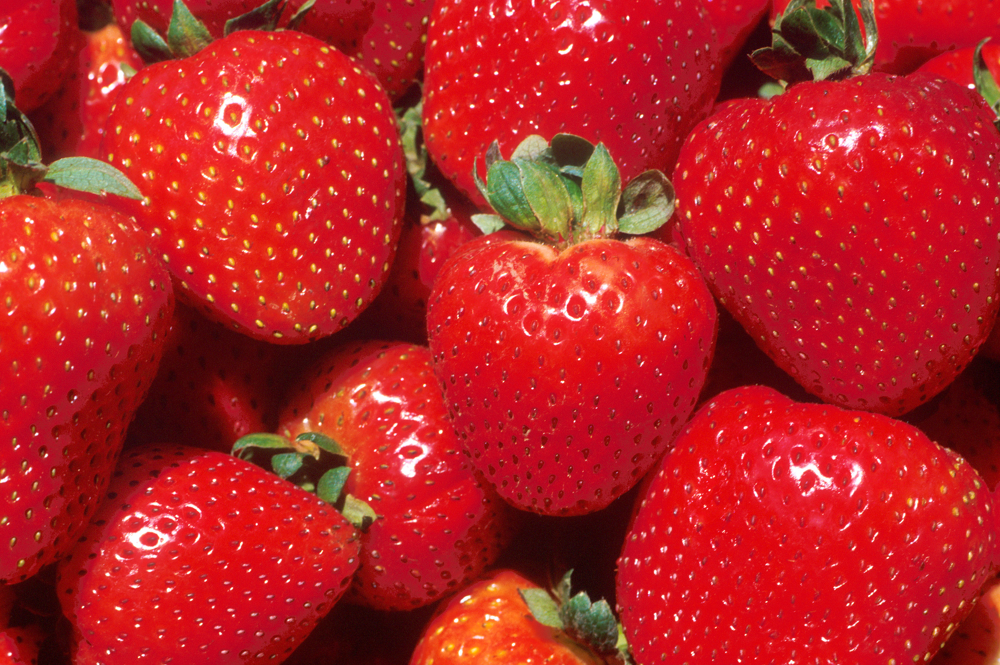

In [2]:
# Image for processing and evaluating
img = Image.open("../Data/Homework1/Strawberries.jpg")
img

In [3]:
# Image Preprocess
preprocess = transforms.Compose([
    transforms.ToTensor()
])

In [4]:
# Image Mean
img_r = preprocess(img)
img_r.mean()

tensor(0.3292)

In [5]:
# Red component mean
img_r[0,:,:].mean()

tensor(0.7124)

In [6]:
# Green component mean
img_r[1,:,:].mean()

tensor(0.1347)

In [7]:
# Blue component mean
img_r[2,:,:].mean()

tensor(0.1404)

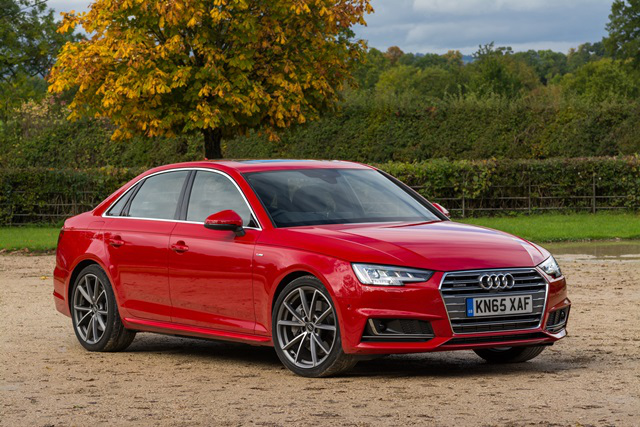

In [8]:
img = Image.open("../Data/Homework1/RedCar.jpg")
img

In [9]:
img_r = preprocess(img)
img_r.mean()

tensor(0.3402)

In [10]:
img_r[0,:,:].mean()

tensor(0.4378)

In [11]:
img_r[1,:,:].mean()

tensor(0.3347)

In [12]:
img_r[2,:,:].mean()

tensor(0.2482)

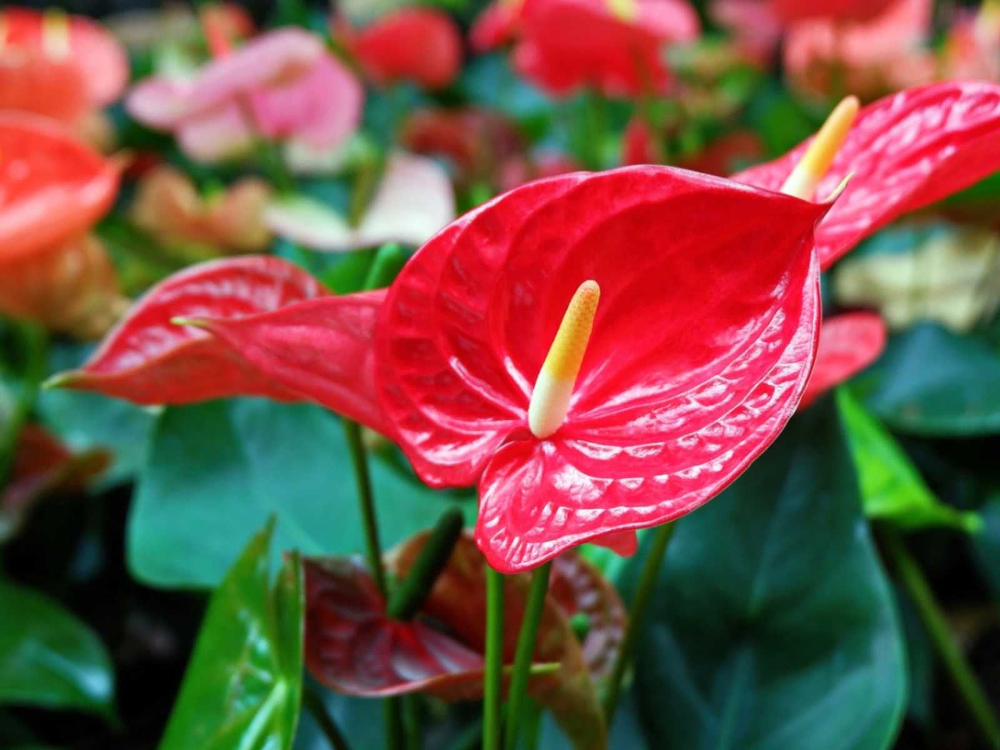

In [13]:
img = Image.open("../Data/Homework1/redFlower.jpg")
img

In [14]:
img_r = preprocess(img)
img_r.mean()

tensor(0.3506)

In [15]:
img_r[0,:,:].mean()

tensor(0.4696)

In [16]:
img_r[1,:,:].mean()

tensor(0.3152)

In [17]:
img_r[2,:,:].mean()

tensor(0.2669)

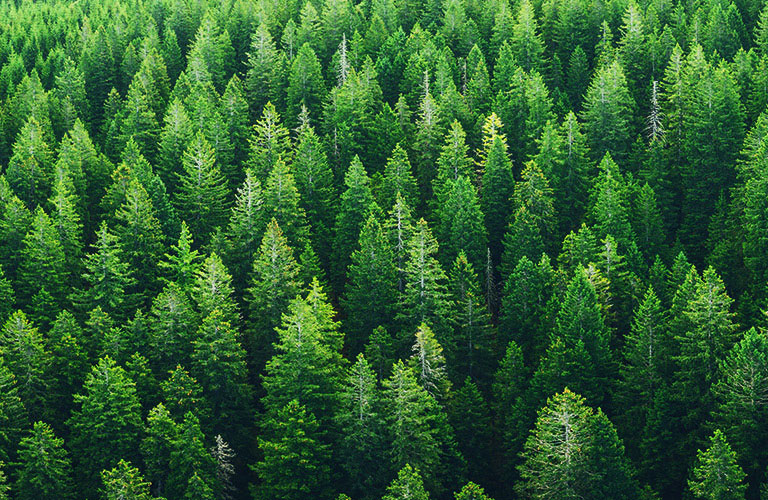

In [18]:
img = Image.open("../Data/Homework1/trees.jpg")
img

In [19]:
img_g = preprocess(img)
img_g.mean()

tensor(0.2514)

In [20]:
img_g[0,:,:].mean()

tensor(0.1907)

In [21]:
img_g[1,:,:].mean()

tensor(0.3756)

In [22]:
img_g[2,:,:].mean()

tensor(0.1879)

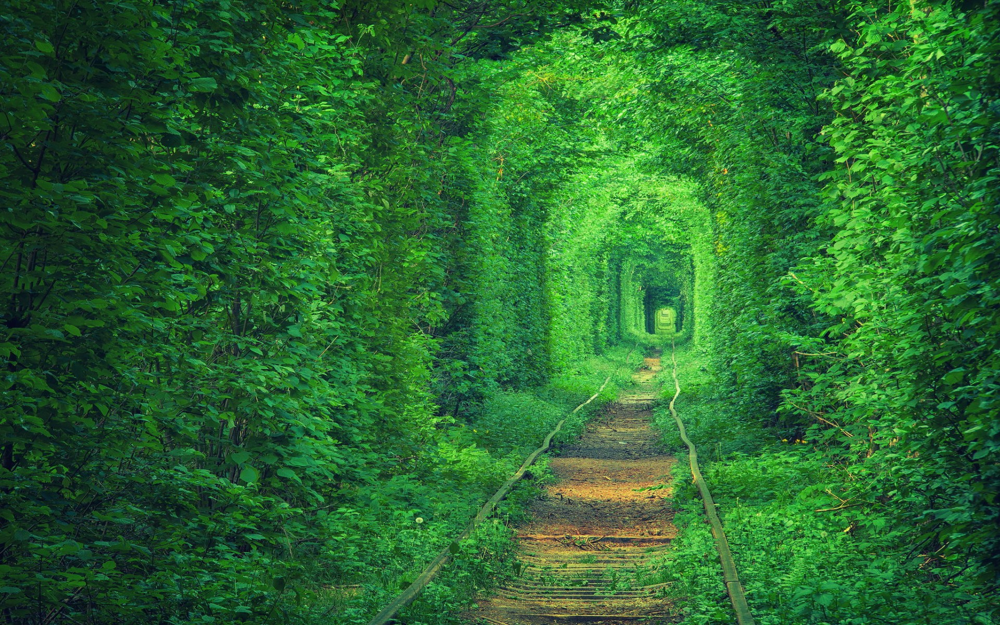

In [23]:
img = Image.open("../Data/Homework1/railroadForest.jpg")
img

In [24]:
img_g = preprocess(img)
img_g.mean()

tensor(0.2518)

In [25]:
img_g[0,:,:].mean()

tensor(0.1647)

In [26]:
img_g[1,:,:].mean()

tensor(0.4056)

In [27]:
img_g[2,:,:].mean()

tensor(0.1852)

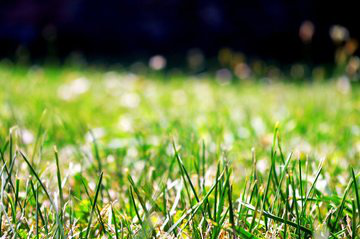

In [28]:
img = Image.open("../Data/Homework1/grass.jpg")
img

In [29]:
img_g = preprocess(img)
img_g.mean()

tensor(0.4056)

In [30]:
img_g[0,:,:].mean()

tensor(0.4419)

In [31]:
img_g[1,:,:].mean()

tensor(0.5070)

In [32]:
img_g[2,:,:].mean()

tensor(0.2679)

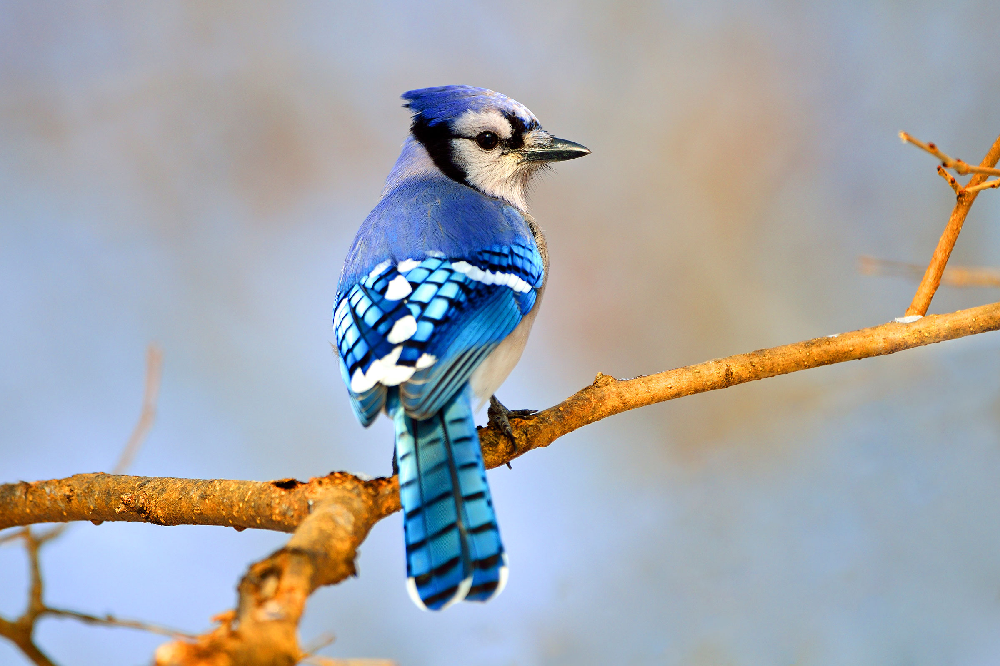

In [33]:
img = Image.open("../Data/Homework1/blueBird.jpg")
img

In [34]:
img_b = preprocess(img)
img_b.mean()

tensor(0.6589)

In [35]:
img_b[0,:,:].mean()

tensor(0.6444)

In [36]:
img_b[1,:,:].mean()

tensor(0.6571)

In [37]:
img_b[2,:,:].mean()

tensor(0.6751)

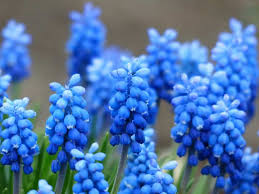

In [38]:
img = Image.open("../Data/Homework1/blueFlower.jpg")
img

In [39]:
img_b = preprocess(img)
img_b.mean()

tensor(0.4779)

In [40]:
img_b[0,:,:].mean()

tensor(0.3064)

In [41]:
img_b[1,:,:].mean()

tensor(0.4601)

In [42]:
img_b[2,:,:].mean()

tensor(0.6673)

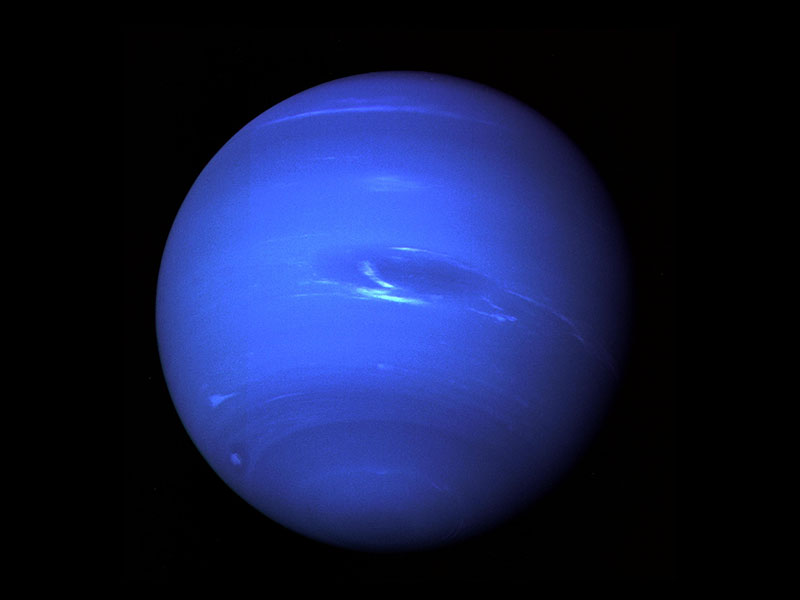

In [43]:
img = Image.open("../Data/Homework1/Neptune.jpg")
img

In [44]:
img_b = preprocess(img)
img_b.mean()

tensor(0.1446)

In [45]:
img_b[0,:,:].mean()

tensor(0.0750)

In [46]:
img_b[1,:,:].mean()

tensor(0.1049)

In [47]:
img_b[2,:,:].mean()

tensor(0.2540)

### Problem 2

In [48]:
# Non-linear Model
def model(t_u, w2, w1, b):
    return w2*t_u**2 + w1*t_u + b

# Loss Function = MSE
def loss_fn(t_p, t_c):
    squared_diffs = (t_p - t_c)**2
    return squared_diffs.mean()

# Training loop
def training_loop(n_epochs, optimizer, params, t_u, t_c):
    for epoch in range(1, n_epochs + 1):
        t_p = model(t_u, *params)
        loss = loss_fn(t_p, t_c)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        if(epoch%500 == 0):
            print("Epoch %d, Loss %f" % (epoch, float(loss)))

    return params

In [49]:
# Linear model
def modelL(t_u, w, b):
    return w*t_u + b

# Linear Training loop
def training_loopL(n_epochs, optimizer, params, t_u, t_c):
    for epoch in range(1, n_epochs + 1):
        t_p = modelL(t_u, *params)
        loss = loss_fn(t_p, t_c)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        if(epoch%500 == 0):
            print("Epoch %d, Loss %f" % (epoch, float(loss)))

    return params

In [50]:
# Output
t_c = [0.5, 14.0, 15.0, 28.0, 11.0, 8.0, 3.0, -4.0, 6.0, 13.0, 21.0]
# Input
t_u = [35.7, 55.9, 58.2, 81.9, 56.3, 48.9, 33.9, 21.8, 48.4, 60.4, 68.4]

# To tensor
t_c = torch.tensor(t_c)
t_u = torch.tensor(t_u)
# Normalize
t_un = t_u*0.1

# Parameters
params = torch.tensor([1.0, 1.0, 0.0], requires_grad=True)
paramsL = torch.tensor([1.0, 0.0], requires_grad=True)

In [51]:
# Perform training loop for non-linear
params = torch.tensor([1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([params], lr=1e-1)
training_loop(n_epochs = 5000, optimizer = optimizer, params = params, t_u = t_un, t_c = t_c)

Epoch 500, Loss nan
Epoch 1000, Loss nan
Epoch 1500, Loss nan
Epoch 2000, Loss nan
Epoch 2500, Loss nan
Epoch 3000, Loss nan
Epoch 3500, Loss nan
Epoch 4000, Loss nan
Epoch 4500, Loss nan
Epoch 5000, Loss nan


tensor([nan, nan, nan], requires_grad=True)

In [52]:
params = torch.tensor([1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([params], lr=1e-2)
training_loop(n_epochs = 5000, optimizer = optimizer, params = params, t_u = t_un, t_c = t_c)

Epoch 500, Loss nan
Epoch 1000, Loss nan
Epoch 1500, Loss nan
Epoch 2000, Loss nan
Epoch 2500, Loss nan
Epoch 3000, Loss nan
Epoch 3500, Loss nan
Epoch 4000, Loss nan
Epoch 4500, Loss nan
Epoch 5000, Loss nan


tensor([nan, nan, nan], requires_grad=True)

In [53]:
params = torch.tensor([1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([params], lr=1e-3)
training_loop(n_epochs = 5000, optimizer = optimizer, params = params, t_u = t_un, t_c = t_c)

Epoch 500, Loss nan
Epoch 1000, Loss nan
Epoch 1500, Loss nan
Epoch 2000, Loss nan
Epoch 2500, Loss nan
Epoch 3000, Loss nan
Epoch 3500, Loss nan
Epoch 4000, Loss nan
Epoch 4500, Loss nan
Epoch 5000, Loss nan


tensor([nan, nan, nan], requires_grad=True)

In [54]:
params = torch.tensor([1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([params], lr=1e-4)
params_q = training_loop(n_epochs = 5000, optimizer = optimizer, params = params, t_u = t_un, t_c = t_c)
params_q

Epoch 500, Loss 10.708596
Epoch 1000, Loss 8.642083
Epoch 1500, Loss 7.171005
Epoch 2000, Loss 6.123477
Epoch 2500, Loss 5.377227
Epoch 3000, Loss 4.845285
Epoch 3500, Loss 4.465788
Epoch 4000, Loss 4.194724
Epoch 4500, Loss 4.000802
Epoch 5000, Loss 3.861744


tensor([ 0.5570, -0.8881, -0.8753], requires_grad=True)

In [55]:
# Perform training loop for linear
optimizer = optim.SGD([paramsL], lr=1e-2)
params_l = training_loopL(n_epochs =5000, optimizer = optimizer, params = paramsL, t_u = t_un, t_c = t_c)
params_l

Epoch 500, Loss 7.860115
Epoch 1000, Loss 3.828538
Epoch 1500, Loss 3.092191
Epoch 2000, Loss 2.957698
Epoch 2500, Loss 2.933134
Epoch 3000, Loss 2.928648
Epoch 3500, Loss 2.927830
Epoch 4000, Loss 2.927679
Epoch 4500, Loss 2.927652
Epoch 5000, Loss 2.927647


tensor([  5.3671, -17.3012], requires_grad=True)

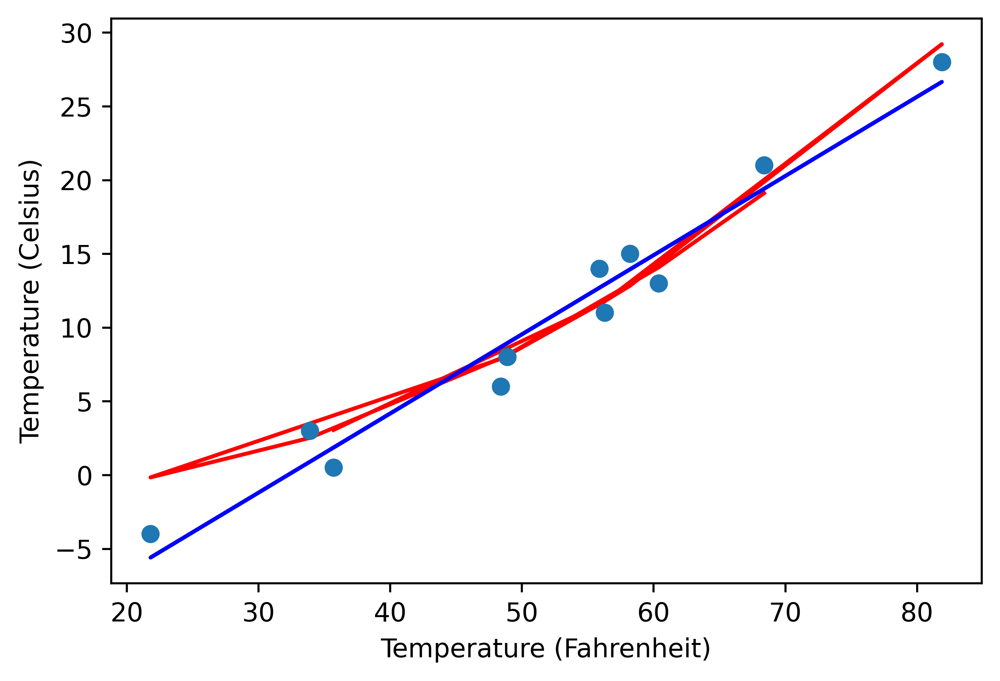

In [56]:
# Visualize output
t_p = model(t_un, *params_q)
t_pL = modelL(t_un, *params_l)
fig = plt.figure(dpi=600)
plt.xlabel("Temperature (Fahrenheit)")
plt.ylabel("Temperature (Celsius)")
plt.plot(t_u.numpy(), t_p.detach().numpy(),'r')
plt.plot(t_u.numpy(), t_c.detach().numpy(), 'o')
plt.plot(t_u.numpy(), t_pL.detach().numpy(),'b')

### Problem 3

In [57]:
# Get the housing dataset
housing = pd.DataFrame(pd.read_csv("../Data/Homework1/Housing.csv"))
housing.head()

,price,area,bedrooms,bathrooms,stories,mainroad,guestroom,basement,hotwaterheating,airconditioning,parking,prefarea,furnishingstatus
0,13300000,7420,4,2,3,yes,no,no,no,yes,2,yes,furnished
1,12250000,8960,4,4,4,yes,no,no,no,yes,3,no,furnished
2,12250000,9960,3,2,2,yes,no,yes,no,no,2,yes,semi-furnished
3,12215000,7500,4,2,2,yes,no,yes,no,yes,3,yes,furnished
4,11410000,7420,4,1,2,yes,yes,yes,no,yes,2,no,furnished


In [58]:
# Get the area, bedrooms, bathrooms, stories, parking, and price
num_vars = ['area', 'bedrooms', 'bathrooms', 'stories', 'parking','price'] 
housing = housing[num_vars] 
housing.head() 

,area,bedrooms,bathrooms,stories,parking,price
0,7420,4,2,3,2,13300000
1,8960,4,4,4,3,12250000
2,9960,3,2,2,2,12250000
3,7500,4,2,2,3,12215000
4,7420,4,1,2,2,11410000


In [59]:
# Convert Panda to tensor
ht = housing.iloc[:,:5]
hp = housing.iloc[:,5]
ht = torch.from_numpy(ht.to_numpy())
hp = torch.from_numpy(hp.to_numpy())
ht = ht.float()
hp = hp.float()

In [60]:
# Normalize input and output
ht_n = ht
for idx in range(5):
    ht_n[:,idx] = ht[:,idx]/ht[:,idx].max()
    #ht_n[:,idx] = (ht[:,idx] - ht.mean())/ht.std()
hp_n = hp/hp.max()
ht_n.min(dim=0)

torch.return_types.min(
values=tensor([0.1019, 0.1667, 0.2500, 0.2500, 0.0000]),
indices=tensor([449, 445,   4,   5,   7]))

In [61]:
# Housing model
def modelH(house, w0, w1, w2, w3, w4, b):
    return house[:,0]*w0 + house[:,1]*w1 + house[:,2]*w2 + house[:,3]*w3 + house[:,4]*w4 + b

# Housing training loop
def training_loopH(n_epochs, optimizer, params, h, hp):
    for epoch in range(1, n_epochs + 1):
        cost_p = modelH(h, *params)
        loss = loss_fn(cost_p, hp)
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        if(epoch%500 == 0):
            print("Epoch %d, Loss %f" % (epoch, float(loss)))

    return params

In [62]:
# Perform training loop for housing model
paramsH = torch.tensor([1.0, 1.0, 1.0, 1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([paramsH], lr=1e-1)
params_h1 = training_loopH(
    n_epochs = 5000,
    optimizer = optimizer,
    params = paramsH,
    h = ht_n,
    hp = hp_n
)
params_h1

Epoch 500, Loss 0.009249
Epoch 1000, Loss 0.008712
Epoch 1500, Loss 0.008662
Epoch 2000, Loss 0.008656
Epoch 2500, Loss 0.008655
Epoch 3000, Loss 0.008655
Epoch 3500, Loss 0.008655
Epoch 4000, Loss 0.008655
Epoch 4500, Loss 0.008655
Epoch 5000, Loss 0.008655


tensor([ 0.4033,  0.0757,  0.3410,  0.1648,  0.0852, -0.0110],
       requires_grad=True)

In [63]:
paramsH = torch.tensor([1.0, 1.0, 1.0, 1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([paramsH], lr=1e-2)
params_h2 = training_loopH(
    n_epochs = 5000,
    optimizer = optimizer,
    params = paramsH,
    h = ht_n,
    hp = hp_n
)
params_h2

Epoch 500, Loss 0.036625
Epoch 1000, Loss 0.020614
Epoch 1500, Loss 0.014962
Epoch 2000, Loss 0.012493
Epoch 2500, Loss 0.011215
Epoch 3000, Loss 0.010466
Epoch 3500, Loss 0.009985
Epoch 4000, Loss 0.009657
Epoch 4500, Loss 0.009422
Epoch 5000, Loss 0.009248


tensor([ 0.4732,  0.2490,  0.3913,  0.1244,  0.0613, -0.1127],
       requires_grad=True)

In [64]:
paramsH = torch.tensor([1.0, 1.0, 1.0, 1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([paramsH], lr=1e-3)
params_h3 = training_loopH(
    n_epochs = 5000,
    optimizer = optimizer,
    params = paramsH,
    h = ht_n,
    hp = hp_n
)
params_h3

Epoch 500, Loss 0.153900
Epoch 1000, Loss 0.076908
Epoch 1500, Loss 0.067506
Epoch 2000, Loss 0.061113
Epoch 2500, Loss 0.055582
Epoch 3000, Loss 0.050742
Epoch 3500, Loss 0.046497
Epoch 4000, Loss 0.042767
Epoch 4500, Loss 0.039485
Epoch 5000, Loss 0.036591


tensor([ 0.6527,  0.5274,  0.6435,  0.4397,  0.3674, -0.6190],
       requires_grad=True)

In [65]:
paramsH = torch.tensor([1.0, 1.0, 1.0, 1.0, 1.0, 0.0], requires_grad=True)
optimizer = optim.SGD([paramsH], lr=1e-4)
params_h4 = training_loopH(
    n_epochs = 5000,
    optimizer = optimizer,
    params = paramsH,
    h = ht_n,
    hp = hp_n
)
params_h4

Epoch 500, Loss 1.681942
Epoch 1000, Loss 1.216091
Epoch 1500, Loss 0.886120
Epoch 2000, Loss 0.652318
Epoch 2500, Loss 0.486582
Epoch 3000, Loss 0.369019
Epoch 3500, Loss 0.285553
Epoch 4000, Loss 0.226223
Epoch 4500, Loss 0.183977
Epoch 5000, Loss 0.153825


tensor([ 0.7610,  0.6397,  0.7580,  0.6496,  0.7651, -0.6784],
       requires_grad=True)

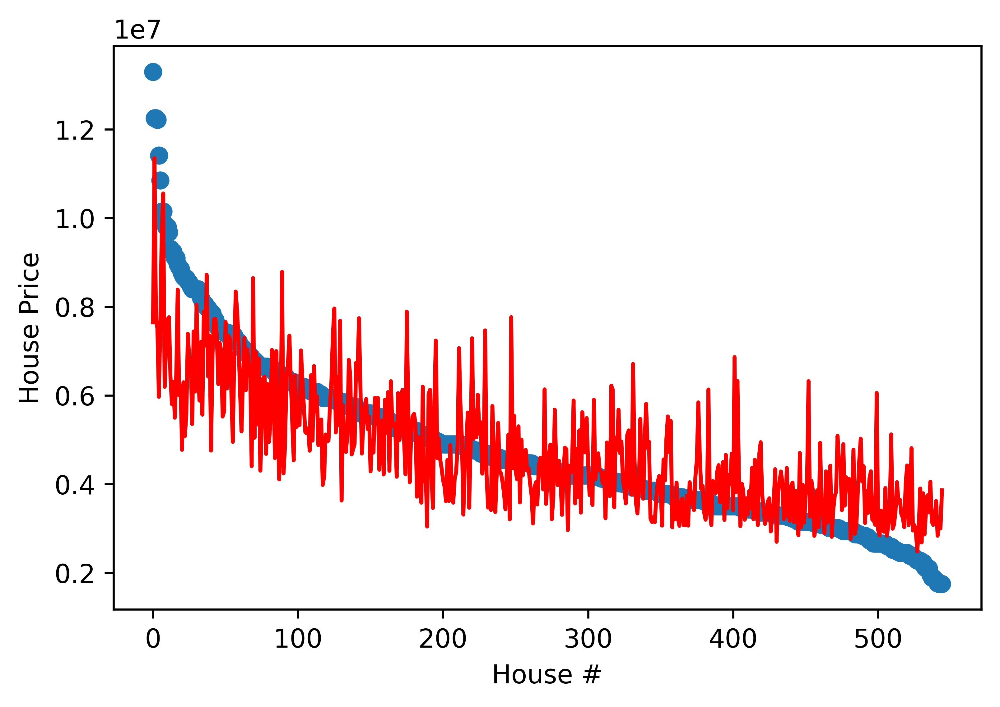

In [66]:
# Visualize the output
h_p = modelH(ht_n, *params_h1)*hp.max()
fig = plt.figure(dpi=600)
plt.xlabel("House #")
plt.ylabel("House Price")
plt.plot(range(545), hp.detach().numpy(), 'o')
plt.plot(range(545), h_p.detach().numpy(),'r')